## Morter 2025 - Improving Attribute-Specific Regularisation in Symbolic Music Variational Autoencoders: Media Artefact Code

***// Do not run all code blocks. Code is included for both training and evaluation purposes. Read below for instructions before running. //***

This Jupyter file includes code for the models proposed in the corresponding report alongside the baseline models. This file is designed to be run in Google Colab.

Code blocks under the 'Dependencies' and 'Dataset' header are required for all models. Run these code blocks first before working with any of the models.

### EVALUATION
Six model files (.pth files) are included for evaluation purposes, one for each model. The code for each model is set up to be run in evaluation mode using the provided model files. Upload these .pth files to local storage before running code.
Note that each plot and evaluation metric is calculated according to a novel, reparameterised sample each time, so the results in the report may not be exactly reproducible, although results will be similar.

Included model files:

Linear model, modal pitch LSR: `MOD_LINEAR_LSR.pth`

CNN model, modal pitch LSR: `MOD_CNN_LSR.pth`

Linear model, rhythmic complexity LSR: `RHY_LINEAR_LSR.pth`

CNN model, rhythmic complexity LSR: `RHY_CNN_LSR.pth`

Linear model, baseline (no LSR): `LINEAR_BASE.pth`

CNN model, baseline (no LSR): `CNN_BASE.pth`

### TRAINING
The models can also be trained from scratch, but be aware of potentially long training times, especially if training is conducted without Google Colab Pro. If a new model has been trained, then skip code block under 'Load model' header.

# Dependencies

### Libraries and constants

In [ ]:
# Downloads two libraries that aren't pre-installed in Colab.
!pip install pretty_midi
!pip install torchinfo

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 48.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.6/54.6 kB 1.6 MB/s eta 0:00:00
  Created wheel for pretty_midi: filename=pretty_midi-0.2.10-py3-none-any.whl size=5592342 sha256=e8beadcc49db241dfda830b8b50e93a92c00f473d317a7b649a705ed9d13dfb8
  Stored in directory: /root/.cache/pip/wheels/a4/f9/9e/08350c27e386558df0ae234e28a8facd145ba45506ddd1b989
Successfully built pretty_midi


In [ ]:
# Library dependencies
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import torchaudio
import pretty_midi
import numpy as np
from torch.utils.data import Dataset, DataLoader
import os
from torchinfo import summary
import matplotlib.pyplot as plt
from google.colab import files
import IPython
from IPython.core.display import display
from sklearn.metrics import mutual_info_score
from sklearn.linear_model import LinearRegression
from tqdm import tqdm
from google.colab import files
import random

In [ ]:
# Constants
BATCH_SIZE = 98
LATENT_DIM = 64

### Helper functions for loss function

In [ ]:
def get_modal_pitch(pianoroll):
  mode = [0, 0]
  # For each pitch, count how many notes are played
  for i in range(pianoroll.shape[0]):
    count = 0
    for j in range(pianoroll.shape[1]):
      if pianoroll[i, j] == 1:
        if j == 0 or pianoroll[i, j-1] == 0:
          count += 1
    # Keep track of the pitch with the most notes played
    if count > mode[1]:
      mode = [i, count]

  # most_common returns [pitch, count], we only need the pitch
  return mode[0]
  # NB: if there are multiple pitches that are played the same amount of times, it will only return the lowest of them.

def pitch_num_to_name(mode):
  # Returns the most common pitch in a readable format
  octave = mode // 12 - 2 # MIDI octaves begin at -2
  note_num = mode % 12
  note_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
  return note_names[note_num] + str(int(octave))

In [ ]:
def get_rhythmic_complexity(pianoroll):
  count = 0
  for i in range(pianoroll.shape[1]):
    for j in range(pianoroll.shape[0]):
      if (pianoroll[j, i] != 0) & (pianoroll[j, i-1] == 0):
        count += 1
        break

  rhythmic_complexity = count / pianoroll.shape[1]
  return rhythmic_complexity

### Evaluation functions for varying the latent dimension, for midpoint checks and plots

In [ ]:
def midi_to_pianoroll(file_path, fs=8, max_len=96):
    pm = pretty_midi.PrettyMIDI(file_path)
    pr = pm.get_piano_roll(fs=fs)
    pr = (pr > 0).astype(np.float32)  # Binary roll (i.e. no velocity information)
    pr = pr[:128, :max_len]  # Truncate
    padded = np.pad(pr, ((0, 0), (0, max(0, max_len - pr.shape[1]))), mode='constant')
    #padded = padded.unsqueeze(0)
    return padded

In [ ]:
# Converts pianoroll to MIDI format for manual inspection
def piano_roll_to_pretty_midi(piano_roll, fs, program=0):
    '''(ported from pretty-midi GitHub examples): https://github.com/craffel/pretty-midi/blob/main/examples/reverse_pianoroll.py
    Convert a Piano Roll array into a PrettyMidi object
    with a single instrument.

    Parameters
    ----------
    piano_roll : np.ndarray, shape=(128,frames), dtype=int
        Piano roll of one instrument
    fs : int
        Sampling frequency of the columns, i.e. each column is spaced apart
        by ``1./fs`` seconds.
    program : int
        The program number of the instrument.

    Returns
    -------
    midi_object : pretty_midi.PrettyMIDI
        A pretty_midi.PrettyMIDI class instance describing
        the piano roll.

    '''
    notes, frames = piano_roll.shape
    pm = pretty_midi.PrettyMIDI()
    instrument = pretty_midi.Instrument(program=program)

    # pad 1 column of zeros so we can acknowledge inital and ending events
    piano_roll = np.pad(piano_roll, [(0, 0), (1, 1)], 'constant')

    # use changes in velocities to find note on / note off events
    velocity_changes = np.nonzero(np.diff(piano_roll).T)

    # keep track on velocities and note on times
    prev_velocities = np.zeros(notes, dtype=int)
    note_on_time = np.zeros(notes)

    for time, note in zip(*velocity_changes):
        # use time + 1 because of padding above
        velocity = piano_roll[note, time + 1]
        time = time / fs
        if velocity > 0:
            if prev_velocities[note] == 0:
                note_on_time[note] = time
                prev_velocities[note] = velocity
        else:
            pm_note = pretty_midi.Note(
                velocity=prev_velocities[note],
                pitch=note,
                start=note_on_time[note],
                end=time)
            instrument.notes.append(pm_note)
            prev_velocities[note] = 0
    pm.instruments.append(instrument)
    return pm

In [ ]:
def linear_vary_constrained_latent_dim(idx, alpha, attribute):
  with torch.no_grad():
    # Add a batch dimension to the input data
    input_data = dataset[idx].unsqueeze(0)
    z_mu, z_logvar = model.encode(input_data)
    z = model.reparameterise(z_mu, z_logvar)
    # Apply the alpha value to the 0th dimension of the latent code
    z[0, 0] += alpha
    recon_z = model.decode(z)
    z_pianoroll = recon_z.view(128, 96).cpu().numpy()
    # Round small numbers down
    z_pianoroll = np.round(z_pianoroll, 2)
    # Round larger numbers up to 1 to create a note
    z_pianoroll = np.ceil(z_pianoroll)
    midi = piano_roll_to_pretty_midi(z_pianoroll, fs=16)
    print(f"Alpha = {alpha}")
    print(f"Most common pitch: {pitch_num_to_name(get_modal_pitch(z_pianoroll))}")
    display(IPython.display.Audio(midi.synthesize(fs=16000), rate=16000))

    if attribute == "mod":
      return(get_modal_pitch(z_pianoroll))
    elif attribute == "rhy":
      return(get_rhythmic_complexity(z_pianoroll))
    else:
      raise ValueError("'attribute' value should be 'mod' or 'rhy'.")

In [ ]:
def cnn_vary_constrained_latent_dim(idx, alpha, attribute):
  with torch.no_grad():
    # Add a batch dimension to the input data
    input_data = dataset[idx].unsqueeze(0).unsqueeze(0)
    z_mu, z_logvar = model.encode(input_data)
    z = model.reparameterise(z_mu, z_logvar)
    # Apply the alpha value to the 0th dimension of the latent code
    z[0, 0] += alpha
    recon_z = model.decode(z)
    z_pianoroll = recon_z.view(128, 96).cpu().numpy()
    # Round small numbers down
    z_pianoroll = np.round(z_pianoroll, 2)
    # Round larger numbers up to 1 to create a note
    z_pianoroll = np.ceil(z_pianoroll)
    midi = piano_roll_to_pretty_midi(z_pianoroll, fs=16)
    print(f"Alpha = {alpha}")
    print(f"Most common pitch: {pitch_num_to_name(get_modal_pitch(z_pianoroll))}")
    display(IPython.display.Audio(midi.synthesize(fs=16000), rate=16000))
    if attribute == "mod":
      return(get_modal_pitch(z_pianoroll))
    elif attribute == "rhy":
      return(get_rhythmic_complexity(z_pianoroll))
    else:
      raise ValueError("'attribute' value should be 'mod' or 'rhy'.")

### Intepretability metric functions

In [ ]:
def linear_interpretability_metric(attribute):
  interpretability_dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)
  z_all = []
  attr_all = []
  for batch_id, batch in enumerate(interpretability_dataloader):
    mu, logvar = model.encode(batch)
    z_tilde = model.reparameterise(mu, logvar)

    # Iterate through the batch and get the most common pitch for each sample
    batch_attrs = []

    if attribute == "mod":
      for i in range(batch.size(0)):
          batch_attrs.append(get_modal_pitch(batch[i]))
    elif attribute == "rhy":
       for i in range(batch.size(0)):
          batch_attrs.append(get_rhythmic_complexity(batch[i]))
    else:
      raise ValueError("'attribute' value should be 'mod' or 'rhy'.")

    attr = torch.tensor(batch_attrs, device=batch.device, dtype=torch.float32)

    z_all.append(z_tilde.cpu().detach().numpy())
    attr_all.append(attr.cpu().detach().numpy())

  z_all = np.concatenate(z_all)
  attr_all = np.concatenate(attr_all)

  mutual_info = np.zeros(LATENT_DIM)
  for i in range(LATENT_DIM):
      mutual_info[i] = mutual_info_score(z_all[:, i], attr_all)
  dim = np.argmax(mutual_info)
  max_mutual_info = np.max(mutual_info)

  reg = LinearRegression().fit(z_all[:, dim:dim+1], attr_all)
  score = reg.score(z_all[:, dim:dim+1], attr_all)
  print("Highest scoring dimension: ", dim)
  print("Regression score: ", score)

In [ ]:
def cnn_interpretability_metric(attribute):
  interpretability_dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)
  z_all = []
  attr_all = []
  for batch_id, batch in enumerate(interpretability_dataloader):
    batch = batch.unsqueeze(1)
    mu, logvar = model.encode(batch)
    z_tilde = model.reparameterise(mu, logvar)

    batch = batch.squeeze(1)

    # Iterate through the batch and get the most common pitch for each sample
    batch_attrs = []
    if attribute == "mod":
      for i in range(batch.size(0)):
          batch_attrs.append(get_modal_pitch(batch[i]))
    elif attribute == "rhy":
       for i in range(batch.size(0)):
          batch_attrs.append(get_rhythmic_complexity(batch[i]))
    else:
      raise ValueError("'attribute' value should be 'mod' or 'rhy'.")

    attr = torch.tensor(batch_attrs, device=batch.device, dtype=torch.float32)

    z_all.append(z_tilde.cpu().detach().numpy())
    attr_all.append(attr.cpu().detach().numpy())

  z_all = np.concatenate(z_all)
  attr_all = np.concatenate(attr_all)

  mutual_info = np.zeros(LATENT_DIM)
  for i in range(LATENT_DIM):
      mutual_info[i] = mutual_info_score(z_all[:, i], attr_all)
  dim = np.argmax(mutual_info)
  max_mutual_info = np.max(mutual_info)

  reg = LinearRegression().fit(z_all[:, dim:dim+1], attr_all)
  score = reg.score(z_all[:, dim:dim+1], attr_all)
  print("Highest scoring dimension: ", dim)
  print("Regression score: ", score)

# Dataset

Downloads the MAESTRO dataset.
The MAESTRO dataset is 200 hours of virtuosic classical piano performances in MIDI format.

See [here](https://magenta.tensorflow.org/datasets/maestro) for more info.

This deviates from the inspiration (Pati & Lerch), which used a Folk music dataset.

In [ ]:
!wget https://storage.googleapis.com/magentadata/datasets/maestro/v3.0.0/maestro-v3.0.0-midi.zip
!unzip maestro-v3.0.0-midi.zip -d maestro
# Delete unnecessary files, so the MAESTRO folder contains only MIDI files and can be iterated through successfully to create the dataset.
!rm ./maestro/maestro-v3.0.0/LICENSE
!rm ./maestro/maestro-v3.0.0/README
!rm ./maestro/maestro-v3.0.0/maestro-v3.0.0.csv
!rm ./maestro/maestro-v3.0.0/maestro-v3.0.0.json

--2025-09-02 08:16:45--  https://storage.googleapis.com/magentadata/datasets/maestro/v3.0.0/maestro-v3.0.0-midi.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 142.251.189.207, 108.177.121.207, 142.250.152.207, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|142.251.189.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 58416533 (56M) [application/octet-stream]
Saving to: ‘maestro-v3.0.0-midi.zip’

maestro-v3.0.0-midi 100%[===================>]  55.71M   233MB/s    in 0.2s    

2025-09-02 08:16:46 (233 MB/s) - ‘maestro-v3.0.0-midi.zip’ saved [58416533/58416533]

Archive:  maestro-v3.0.0-midi.zip
  inflating: maestro/maestro-v3.0.0/2004/MIDI-Unprocessed_XP_08_R1_2004_01-02_ORIG_MID--AUDIO_08_R1_2004_01_Track01_wav.midi  
  inflating: maestro/maestro-v3.0.0/2004/MIDI-Unprocessed_XP_09_R1_2004_05_ORIG_MID--AUDIO_09_R1_2004_06_Track06_wav.midi  
  inflating: maestro/maestro-v3.0.0/2004/MIDI-Unprocessed_XP_14_R1_2004_01-03_ORIG_M

In [ ]:
class MaestroDataset(Dataset):
    def __init__(self, data_dir):
        self.data_dir = data_dir
        self.midi_files = self._get_midi_files()
        self.data = [midi_to_pianoroll(f) for f in self.midi_files]

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        # Returns pianoroll of the data at the given index.
        return torch.tensor(self.data[idx])

    def _get_midi_files(self):
          # Collects all midi file paths from the given data directory.
          midi_files = []
          for dirpath, _, filenames in os.walk(self.data_dir):
              for filename in filenames:

                  file_path = os.path.join(dirpath, filename)
                  midi_files.append(file_path)
          return midi_files

# This path should be where the midi data is stored if downloaded using the cell above.
midi_paths='./maestro/maestro-v3.0.0'
# Loads the data into a PyTorch Dataset object for training.
dataset = MaestroDataset(midi_paths)

In [ ]:
# Example data value to manually inspect shape
dataset[345].shape # Should be of size [128, 96]

torch.Size([128, 96])



#------------------------------------------------------------------------------------------





# Modal pitch regularisation models

## Linear LSR

### Model

In [ ]:
class LINEAR_LSR(nn.Module):
    def __init__(self, latent_dim):  # Pianoroll input: 128 pitches, 96 time steps
        super(LINEAR_LSR, self).__init__()
        self.input_dim=128*96
        self.flatten_input = nn.Flatten()
        self.fc1 = nn.Linear(self.input_dim, 512)
        self.fc2 = nn.Linear(512, 256)
        self.fc31 = nn.Linear(256, latent_dim)  # mean
        self.fc32 = nn.Linear(256, latent_dim)  # logvar

        self.fc4 = nn.Linear(latent_dim, 256)
        self.fc5 = nn.Linear(256, 512)
        self.fc6 = nn.Linear(512, self.input_dim)

    def encode(self, x):
        x = self.flatten_input(x)
        h = F.relu(self.fc1(x))
        h = F.relu(self.fc2(h))
        return self.fc31(h), self.fc32(h)

    def reparameterise(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        h = F.relu(self.fc4(z))
        h = F.relu(self.fc5(h))
        return torch.sigmoid(self.fc6(h))

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterise(mu, logvar)
        z = self.decode(z)
        z = z.reshape(-1, 128, 96)
        return z, mu, logvar

# Instantiate the model with the specified latent dimensions
model = LINEAR_LSR(LATENT_DIM)

In [ ]:
# Outputs a summary of the model for manual checks
summary(model, input_size=(1, 1, 128, 96))

Layer (type:depth-idx)                   Output Shape              Param #
LINEAR_LSR                               [1, 128, 96]              --
├─Flatten: 1-1                           [1, 12288]                --
├─Linear: 1-2                            [1, 512]                  6,291,968
├─Linear: 1-3                            [1, 256]                  131,328
├─Linear: 1-4                            [1, 64]                   16,448
├─Linear: 1-5                            [1, 64]                   16,448
├─Linear: 1-6                            [1, 256]                  16,640
├─Linear: 1-7                            [1, 512]                  131,584
├─Linear: 1-8                            [1, 12288]                6,303,744
Total params: 12,908,160
Trainable params: 12,908,160
Non-trainable params: 0
Total mult-adds (Units.MEGABYTES): 12.91
Input size (MB): 0.05
Forward/backward pass size (MB): 0.11
Params size (MB): 51.63
Estimated Total Size (MB): 51.79

### Training (NB: Not required for evaluation)

#### Loss function

In [ ]:
def loss_fn(recon_x, x, mu, logvar, attr):
  # Standard VAE loss function computes the sum of the reconstruction loss (binary cross-entropy) and the KL divergence.
  BCE = F.binary_cross_entropy(recon_x, x, reduction='sum')
  KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

  # Additional term to enforce the 0th latent dimension to map to most common note
  z = model.reparameterise(mu, logvar)
  # Calculates the MSE between the value of a certain element's 0th dimension of latent code, and its modal pitch.
  # If this loss is minimised, then the 0th latent dimension will correspond to modal pitch. If we alter the 0th dimension of a given latent code (e.g. the encoded code of a user input), then the decoded output should see a corresponding change in the modal pitch.
  LSR = F.mse_loss(z[:, 0], attr)

  LSR_coef = 20
  KLD_coef = 0.1

  return BCE + KLD_coef * KLD + LSR_coef * LSR

#### Training loop

In [ ]:
optimiser = torch.optim.Adam(model.parameters(), lr=1e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimiser, step_size=5, gamma=0.1)
data_loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

def train(model, device, train_loader, optimiser, epoch):
  model.to(device)
  model.train()
  train_loss = 0
  for batch_idx, data in enumerate(train_loader):
      data = data.to(device)
      optimiser.zero_grad()
      recon_batch, mu, logvar = model(data)

      # Get the actual batch size for the current batch
      current_batch_size = data.size(0)

      # Calculate the most common pitch for each sample in the batch
      most_common_pitches = []
      for i in range(current_batch_size):
          most_common_pitches.append(get_modal_pitch(data[i]))

      # Create a tensor of the most common pitches for each sample
      attr = torch.tensor(most_common_pitches, device=device, dtype=torch.float32)

      loss = loss_fn(recon_batch, data, mu, logvar, attr)
      loss.backward()
      train_loss += loss.item()
      optimiser.step()

  avg_loss = train_loss / len(train_loader.dataset)
  print(f'Epoch {epoch}, Loss: {avg_loss}')
  return avg_loss

def train_loop(epochs):
  losses = []
  for epoch in range(1, epochs + 1):
    avg_loss = train(model, device, data_loader, optimiser, epoch)
    losses.append(avg_loss)
    scheduler.step()

  plt.figure(figsize=(10, 5))
  plt.plot(range(1, epochs+1), losses, marker='o', label='Training Loss')
  plt.xlabel('Epoch')
  plt.ylabel('Loss')
  plt.title('Loss Over Epochs')
  plt.legend()
  plt.show()

Epoch 1, Loss: 2489684.319749216
Epoch 2, Loss: 1055050.8996865205
Epoch 3, Loss: 923089.6677115988
Epoch 4, Loss: 687256.8042711599
Epoch 5, Loss: 602737.3354231975
Epoch 6, Loss: 518948.65830721
Epoch 7, Loss: 471678.7445141066
Epoch 8, Loss: 474651.36677115987
Epoch 9, Loss: 433676.3009404389
Epoch 10, Loss: 472541.6379310345
Epoch 11, Loss: 443538.1238244514
Epoch 12, Loss: 441197.0721003135
Epoch 13, Loss: 425514.1347962383
Epoch 14, Loss: 462475.9263322884
Epoch 15, Loss: 389265.43926332286
Epoch 16, Loss: 436850.0971786834
Epoch 17, Loss: 385182.0229231975
Epoch 18, Loss: 426156.3652037617
Epoch 19, Loss: 448952.4278996865
Epoch 20, Loss: 388067.7198275862


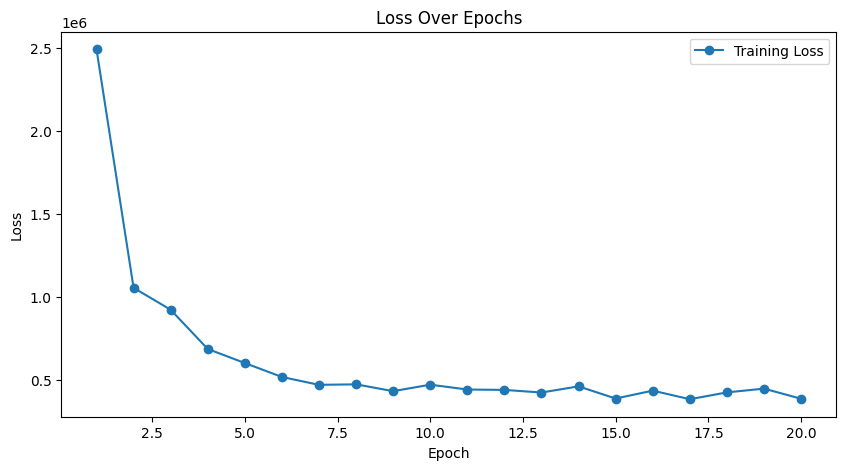

In [ ]:
train_loop(epochs=20)

#### Save model

In [ ]:
torch.save(model.state_dict(), './MOD_LINEAR_LSR_XXXX2025.pth')

In [ ]:
files.download('./MOD_LINEAR_LSR_XXXX2025.pth')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Load model

In [ ]:
# Run if using the pre-trained model.
# If you have trained your own model in the same session, skip this code block.
# If you have trained your own model in a previous session, load your own .pth file below.
model = LINEAR_LSR(LATENT_DIM)
model.load_state_dict(torch.load('./MOD_LINEAR_LSR.pth'))

<All keys matched successfully>

### Evaluation

#### Plot

In [ ]:
model.eval()

modal_pitches = []
alpha_all     = []

for alpha in np.arange(-20, 20, 4):
  modal = linear_vary_constrained_latent_dim(1, alpha, attribute="mod")
  modal_pitches.append(modal)

  alpha_all.append(alpha)

Alpha = -20
Most common pitch: C#3


Alpha = -16
Most common pitch: C#2


Alpha = -12
Most common pitch: E1


Alpha = -8
Most common pitch: G5


Alpha = -4
Most common pitch: A-1


Alpha = 0
Most common pitch: D-1


Alpha = 4
Most common pitch: B5


Alpha = 8
Most common pitch: D1


Alpha = 12
Most common pitch: F1


Alpha = 16
Most common pitch: B3


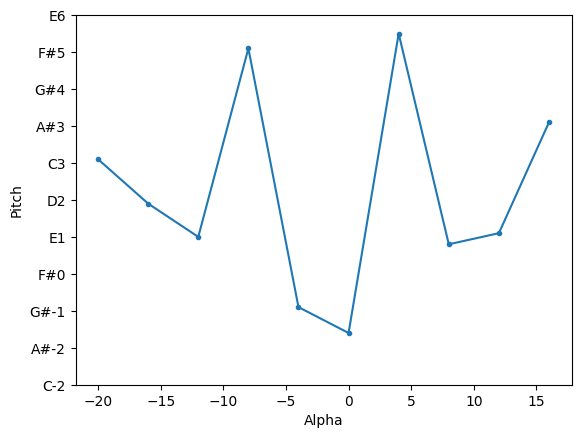

In [ ]:
plt.plot(alpha_all, modal_pitches, marker = ".")

current_values = plt.gca().get_yticks()
plt.gca().set_yticks(current_values)
plt.gca().set_yticklabels(pitch_num_to_name(int(x)) for x in current_values)

plt.xlabel('Alpha')
plt.ylabel('Pitch')
plt.show()

#### Interpretability metric

In [ ]:
linear_interpretability_metric(attribute="mod")

Highest scoring dimension:  0
Regression score:  0.0032970309257507324


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/loc

## CNN LSR

### Model

In [ ]:
class CNN_LSR(nn.Module):
    def __init__(self, latent_dim):  # Pianoroll input: 128 pitches, 96 time steps
        super(CNN_LSR, self).__init__()
        self.latent_dim = latent_dim
        self.input_size=128*96
        self.flattened_size = 1120
        #self.flatten_input = nn.Flatten()
        self.encoder_layers = nn.Sequential(
        nn.Conv2d(1, 512, kernel_size=3, stride=2, padding=2),
        nn.BatchNorm2d(512),
        nn.ReLU(),
        nn.Conv2d(512, 256, kernel_size=3, stride=2, padding=2),
        nn.BatchNorm2d(256),
        nn.ReLU(),
        nn.Conv2d(256, 128, kernel_size=3, stride=2, padding=1),
        nn.BatchNorm2d(128),
        nn.ReLU(),
        nn.Conv2d(128, 64, kernel_size=3, stride=2, padding=1),
        nn.BatchNorm2d(64),
        nn.ReLU(),
        nn.Conv2d(64, 32, kernel_size=3, stride=(2,1), padding=1),
        nn.Flatten(),
        )

        self.fc1 = nn.Linear(self.flattened_size, self.latent_dim)  # mean
        self.fc2 = nn.Linear(self.flattened_size, self.latent_dim)  # logvar

        self.decoder_fc = nn.Linear(in_features=self.latent_dim, out_features=self.flattened_size)

        self.decoder_layers = nn.Sequential(
          nn.ConvTranspose2d(32, 32, kernel_size=3, stride=(2,1), padding=1),
          nn.BatchNorm2d(32),
          nn.ReLU(),
          nn.ConvTranspose2d(32, 64, kernel_size=3, stride=2, padding=1),
          nn.BatchNorm2d(64),
          nn.ReLU(),
          nn.ConvTranspose2d(64, 128, kernel_size=3, stride=2, padding=1),
          nn.BatchNorm2d(128),
          nn.ReLU(),
          nn.ConvTranspose2d(128, 256, kernel_size=3, stride=2, padding=1),
          nn.BatchNorm2d(256),
          nn.ReLU(),
          nn.ConvTranspose2d(256, 1, kernel_size=3, stride=2, padding=2, output_padding=1),
          nn.Sigmoid()
        )

    def encode(self, x):
        x = self.encoder_layers(x)
        mu = self.fc1(x)
        logvar = self.fc2(x)
        return mu, logvar

    def reparameterise(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        z = self.decoder_fc(z)
        z = z.reshape(-1, 32, 5, 7)
        z = self.decoder_layers(z)
        return z

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterise(mu, logvar)
        z = self.decode(z)
        return z, mu, logvar

# Instantiate the model with the specified latent dimensions
model = CNN_LSR(LATENT_DIM)

In [ ]:
# Outputs a summary of the model for manual checks
summary(model, input_size=(98, 1, 128, 96))

Layer (type:depth-idx)                   Output Shape              Param #
CNN_LSR                                  [98, 1, 128, 96]          --
├─Sequential: 1-1                        [98, 1120]                --
│    └─Conv2d: 2-1                       [98, 512, 65, 49]         5,120
│    └─BatchNorm2d: 2-2                  [98, 512, 65, 49]         1,024
│    └─ReLU: 2-3                         [98, 512, 65, 49]         --
│    └─Conv2d: 2-4                       [98, 256, 34, 26]         1,179,904
│    └─BatchNorm2d: 2-5                  [98, 256, 34, 26]         512
│    └─ReLU: 2-6                         [98, 256, 34, 26]         --
│    └─Conv2d: 2-7                       [98, 128, 17, 13]         295,040
│    └─BatchNorm2d: 2-8                  [98, 128, 17, 13]         256
│    └─ReLU: 2-9                         [98, 128, 17, 13]         --
│    └─Conv2d: 2-10                      [98, 64, 9, 7]            73,792
│    └─BatchNorm2d: 2-11                 [98, 64, 9, 7]      

### Training (NB: Not required for evaluation)

#### Loss function

In [ ]:
def loss_fn(recon_x, x, mu, logvar, attr):
  # Standard VAE loss function computes the sum of the reconstruction loss (binary cross-entropy) and the KL divergence.
  recon_x = recon_x.squeeze(1)
  BCE = F.binary_cross_entropy(recon_x, x, reduction='sum')
  KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

  # Additional term to enforce the 0th latent dimension to map to most common note
  z = model.reparameterise(mu, logvar)
  # Calculates the MSE between the value of a certain element's 0th dimension of latent code, and its modal pitch.
  # If this loss is minimised, then the 0th latent dimension will correspond to modal pitch. If we alter the 0th dimension of a given latent code (e.g. the encoded code of a user input), then the decoded output should see a corresponding change in the modal pitch.
  LSR = F.mse_loss(z[:, 0], attr)

  LSR_coef = 50
  KLD_coef = 0.1

  return BCE + KLD_coef * KLD + LSR_coef * LSR

#### Training loop

In [ ]:
optimiser = torch.optim.Adam(model.parameters(), lr=1e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimiser, step_size=5, gamma=0.1)
data_loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

def train(model, device, train_loader, optimiser, epoch):
  model.to(device)
  model.train()
  train_loss = 0
  for batch_idx, data in enumerate(train_loader):
      data = data.to(device)
      optimiser.zero_grad()
      data = data.unsqueeze(1)
      recon_batch, mu, logvar = model(data)

      # Get the actual batch size for the current batch
      current_batch_size = data.size(0)
      # Calculate the most common pitch for each sample in the batch
      modal_pitches = []
      data = data.squeeze(1)
      for i in range(current_batch_size):
          modal_pitches.append(get_modal_pitch(data[i]))

      # Create a tensor of the most common pitches for each sample
      attr = torch.tensor(modal_pitches, device=device, dtype=torch.float32)

      loss = loss_fn(recon_batch, data, mu, logvar, attr)
      loss.backward()
      train_loss += loss.item()
      optimiser.step()

  avg_loss = train_loss / len(train_loader.dataset)
  print(f'Epoch {epoch}, Loss: {avg_loss}')
  return avg_loss

def train_loop(epochs):
  losses = []
  for epoch in range(1, epochs + 1):
    avg_loss = train(model, device, data_loader, optimiser, epoch)
    losses.append(avg_loss)
    scheduler.step()

  plt.figure(figsize=(10, 5))
  plt.plot(range(1, epochs+1), losses, marker='o', label='Training Loss')
  plt.xlabel('Epoch')
  plt.ylabel('Loss')
  plt.title('Loss Over Epochs')
  plt.legend()
  plt.show()

Epoch 1, Loss: 2008.584608119857
Epoch 2, Loss: 1509.4469834091522
Epoch 3, Loss: 1349.710496669279
Epoch 4, Loss: 1256.9100521649686
Epoch 5, Loss: 1188.227500413279
Epoch 6, Loss: 1160.9605121672341
Epoch 7, Loss: 1154.4080232721885
Epoch 8, Loss: 1154.2823666180936
Epoch 9, Loss: 1151.7326109117848
Epoch 10, Loss: 1143.0319097154193
Epoch 11, Loss: 1141.1917774355898
Epoch 12, Loss: 1139.8149559475412
Epoch 13, Loss: 1137.5384219178586
Epoch 14, Loss: 1143.0918366722178
Epoch 15, Loss: 1137.2931285128698
Epoch 16, Loss: 1143.0488449622844
Epoch 17, Loss: 1140.713758510482
Epoch 18, Loss: 1135.7382552287422
Epoch 19, Loss: 1135.943299870506
Epoch 20, Loss: 1136.6026515661736


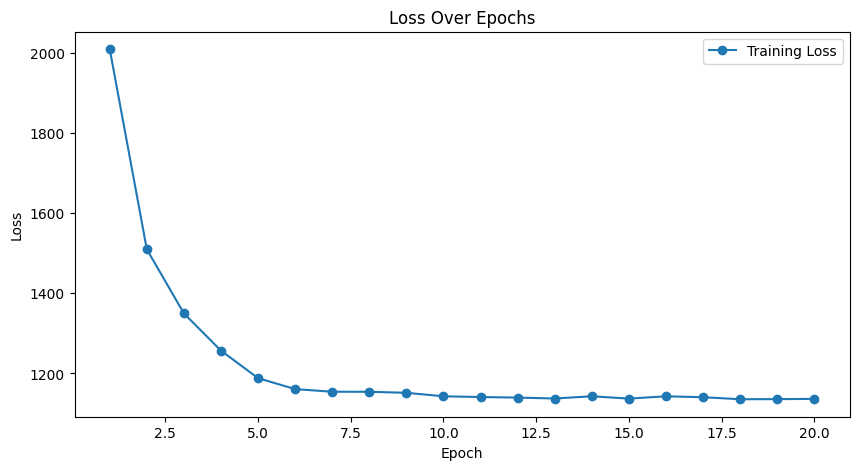

In [ ]:
train_loop(epochs=20)

#### Save model

In [ ]:
torch.save(model.state_dict(), './MOD_CNN_LSR_XXXX2025.pth')

In [ ]:
files.download('./MOD_CNN_LSR_XXXX2025.pth')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Load model

In [ ]:
# Run if using the pre-trained model.
# If you have trained your own model in the same session, skip this code block.
# If you have trained your own model in a previous session, load your own .pth file below.
model = CNN_LSR(LATENT_DIM)
model.load_state_dict(torch.load('MOD_CNN_LSR.pth'))

<All keys matched successfully>

### Evaluation

#### Plot

In [ ]:
model.eval()

modal_pitches = []
alpha_all     = []

for alpha in np.arange(-20, 20, 4):
  modal = cnn_vary_constrained_latent_dim(1, alpha, attribute="mod")
  modal_pitches.append(modal)

  alpha_all.append(alpha)

Alpha = -20
Most common pitch: G0


Alpha = -16
Most common pitch: G0


Alpha = -12
Most common pitch: B5


Alpha = -8
Most common pitch: B6


Alpha = -4
Most common pitch: D#8


Alpha = 0
Most common pitch: D#8


Alpha = 4
Most common pitch: B6


Alpha = 8
Most common pitch: D#8


Alpha = 12
Most common pitch: D#8


Alpha = 16
Most common pitch: G8


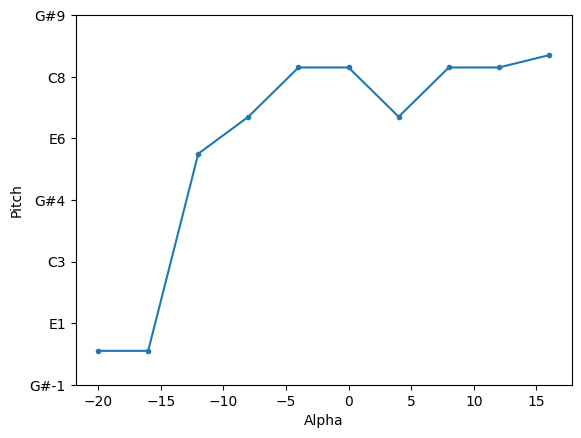

In [ ]:
plt.plot(alpha_all, modal_pitches, marker = ".")

current_values = plt.gca().get_yticks()
plt.gca().set_yticks(current_values)
plt.gca().set_yticklabels(pitch_num_to_name(int(x)) for x in current_values)

plt.xlabel('Alpha')
plt.ylabel('Pitch')
plt.show()

#### Interpretability metric

In [ ]:
cnn_interpretability_metric(attribute="mod")

Highest scoring dimension:  0
Regression score:  0.003740847110748291


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/loc

# Rhythmic complexity regularisation models

## Linear LSR

### Model

In [ ]:
class LINEAR_LSR(nn.Module):
    def __init__(self, latent_dim):  # Pianoroll input: 128 pitches, 96 time steps
        super(LINEAR_LSR, self).__init__()
        self.input_dim=128*96
        self.flatten_input = nn.Flatten()
        self.fc1 = nn.Linear(self.input_dim, 512)
        self.fc2 = nn.Linear(512, 256)
        self.fc31 = nn.Linear(256, latent_dim)  # mean
        self.fc32 = nn.Linear(256, latent_dim)  # logvar

        self.fc4 = nn.Linear(latent_dim, 256)
        self.fc5 = nn.Linear(256, 512)
        self.fc6 = nn.Linear(512, self.input_dim)

    def encode(self, x):
        x = self.flatten_input(x)
        h = F.relu(self.fc1(x))
        h = F.relu(self.fc2(h))
        return self.fc31(h), self.fc32(h)

    def reparameterise(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        h = F.relu(self.fc4(z))
        h = F.relu(self.fc5(h))
        return torch.sigmoid(self.fc6(h))

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterise(mu, logvar)
        z = self.decode(z)
        z = z.reshape(-1, 128, 96)
        return z, mu, logvar

# Instantiate the model with the specified latent dimensions
model = LINEAR_LSR(LATENT_DIM)

In [ ]:
# Outputs a summary of the model for manual checks
summary(model, input_size=(1, 1, 128, 96))

Layer (type:depth-idx)                   Output Shape              Param #
LINEAR_LSR                               [1, 128, 96]              --
├─Flatten: 1-1                           [1, 12288]                --
├─Linear: 1-2                            [1, 512]                  6,291,968
├─Linear: 1-3                            [1, 256]                  131,328
├─Linear: 1-4                            [1, 64]                   16,448
├─Linear: 1-5                            [1, 64]                   16,448
├─Linear: 1-6                            [1, 256]                  16,640
├─Linear: 1-7                            [1, 512]                  131,584
├─Linear: 1-8                            [1, 12288]                6,303,744
Total params: 12,908,160
Trainable params: 12,908,160
Non-trainable params: 0
Total mult-adds (Units.MEGABYTES): 12.91
Input size (MB): 0.05
Forward/backward pass size (MB): 0.11
Params size (MB): 51.63
Estimated Total Size (MB): 51.79

### Training (NB: Not required for evaluation)

#### Loss function

In [ ]:
def loss_fn(recon_x, x, mu, logvar, attr):
  # Standard VAE loss function computes the sum of the reconstruction loss (binary cross-entropy) and the KL divergence.
  BCE = F.binary_cross_entropy(recon_x, x, reduction='sum')
  KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

  z = model.reparameterise(mu, logvar)
  # Calculates the MSE between the value of a certain element's 0th dimension of latent code, and its rhythmic complexity.
  LSR = F.mse_loss(z[:, 0], attr)

  LSR_coef = 10000
  KLD_coef = 0.1

  return BCE + KLD_coef * KLD + LSR_coef * LSR

#### Training loop

In [ ]:
optimiser = torch.optim.Adam(model.parameters(), lr=1e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimiser, step_size=5, gamma=0.1)
data_loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

def train(model, device, train_loader, optimiser, epoch):
  model.to(device)
  model.train()
  train_loss = 0
  for batch_idx, data in enumerate(train_loader):
      data = data.to(device)
      optimiser.zero_grad()
      recon_batch, mu, logvar = model(data)

      # Get the actual batch size for the current batch
      current_batch_size = data.size(0)

      # Calculate the rhythmic complexity for each sample in the batch
      rhythmic_complexities = []
      for i in range(current_batch_size):
          rhythmic_complexities.append(get_rhythmic_complexity(data[i]))

      # Create a tensor of the rhythmic complexity for each sample
      attr = torch.tensor(rhythmic_complexities, device=device, dtype=torch.float32)

      loss = loss_fn(recon_batch, data, mu, logvar, attr)
      loss.backward()
      train_loss += loss.item()
      optimiser.step()

  avg_loss = train_loss / len(train_loader.dataset)
  print(f'Epoch {epoch}, Loss: {avg_loss}')
  return avg_loss

def train_loop(epochs):
  losses = []
  for epoch in range(1, epochs + 1):
    avg_loss = train(model, device, data_loader, optimiser, epoch)
    losses.append(avg_loss)
    scheduler.step()

  plt.figure(figsize=(10, 5))
  plt.plot(range(1, epochs+1), losses, marker='o', label='Training Loss')
  plt.xlabel('Epoch')
  plt.ylabel('Loss')
  plt.title('Loss Over Epochs')
  plt.legend()
  plt.show()

Epoch 1, Loss: 5180.580947541144
Epoch 2, Loss: 1467.370524343652
Epoch 3, Loss: 1274.9755480536098
Epoch 4, Loss: 1192.529046803059
Epoch 5, Loss: 1153.6675990950725
Epoch 6, Loss: 1133.0235876962308
Epoch 7, Loss: 1129.7773779985673
Epoch 8, Loss: 1125.8919180269152
Epoch 9, Loss: 1123.1730954161258
Epoch 10, Loss: 1123.4764530576508
Epoch 11, Loss: 1121.5318509762565
Epoch 12, Loss: 1117.0864399398756
Epoch 13, Loss: 1117.9949564679664
Epoch 14, Loss: 1116.9470825195312
Epoch 15, Loss: 1118.9143915923785
Epoch 16, Loss: 1118.1601288894128
Epoch 17, Loss: 1118.9430603218677
Epoch 18, Loss: 1116.6794108328027
Epoch 19, Loss: 1117.0312201520867
Epoch 20, Loss: 1117.4954304949242


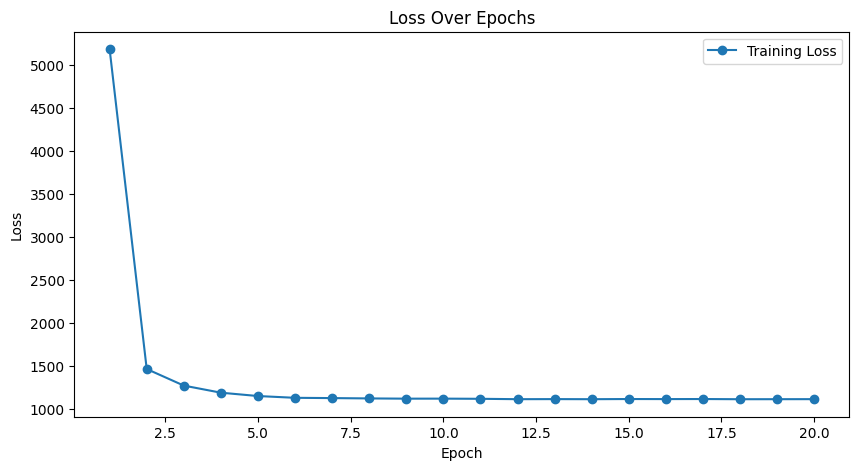

In [ ]:
train_loop(epochs=20)

#### Save model

In [ ]:
torch.save(model.state_dict(), './RHY_LINEAR_LSR_XXXX2025.pth')

In [ ]:
files.download('./RHY_LINEAR_LSR_XXXX2025.pth')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Load model

In [ ]:
# Run if using the pre-trained model.
# If you have trained your own model in the same session, skip this code block.
# If you have trained your own model in a previous session, load your own .pth file below.
model = LINEAR_LSR(LATENT_DIM)
model.load_state_dict(torch.load('./RHY_LINEAR_LSR.pth'))

<All keys matched successfully>

### Evaluation

#### Plot

In [ ]:
model.eval()

rhythmic_complexity_all = []
alpha_all               = []

for alpha in np.arange(-20, 20, 4):
  rhythmic_complexity = linear_vary_constrained_latent_dim(1, alpha, attribute="rhy")
  rhythmic_complexity_all.append(rhythmic_complexity)
  alpha_all.append(alpha)

Alpha = -20
Most common pitch: B2


Alpha = -16
Most common pitch: C#2


Alpha = -12
Most common pitch: E1


Alpha = -8
Most common pitch: D#0


Alpha = -4
Most common pitch: A#5


Alpha = 0
Most common pitch: E0


Alpha = 4
Most common pitch: G5


Alpha = 8
Most common pitch: C#1


Alpha = 12
Most common pitch: G2


Alpha = 16
Most common pitch: G3


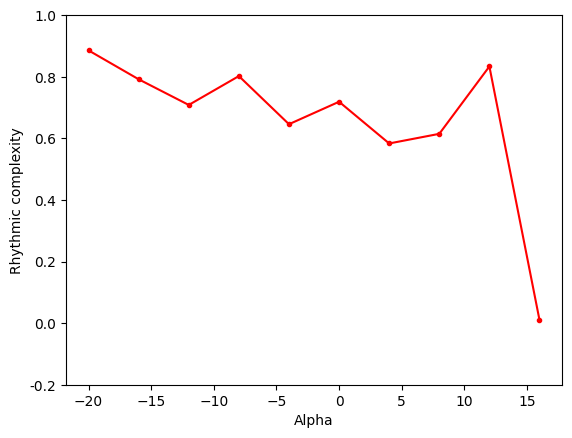

In [ ]:
plt.plot(alpha_all, rhythmic_complexity_all, 'red', marker = ".")


current_values = plt.gca().get_yticks()
plt.gca().set_yticks(current_values)
plt.gca().set_yticklabels(round(x,2) for x in current_values)

plt.xlabel('Alpha')
plt.ylabel('Rhythmic complexity')
plt.show()

#### Interpretability metric

In [ ]:
linear_interpretability_metric(attribute="rhy")

Highest scoring dimension:  0
Regression score:  0.46649277210235596


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/loc

## CNN LSR

### Model

In [ ]:
class CNN_LSR(nn.Module):
    def __init__(self, latent_dim):  # Pianoroll input: 128 pitches, 96 time steps
        super(CNN_LSR, self).__init__()
        self.latent_dim = latent_dim
        self.input_size=128*96
        self.flattened_size = 1120
        #self.flatten_input = nn.Flatten()
        self.encoder_layers = nn.Sequential(
        nn.Conv2d(1, 512, kernel_size=3, stride=2, padding=2),
        nn.BatchNorm2d(512),
        nn.ReLU(),
        nn.Conv2d(512, 256, kernel_size=3, stride=2, padding=2),
        nn.BatchNorm2d(256),
        nn.ReLU(),
        nn.Conv2d(256, 128, kernel_size=3, stride=2, padding=1),
        nn.BatchNorm2d(128),
        nn.ReLU(),
        nn.Conv2d(128, 64, kernel_size=3, stride=2, padding=1),
        nn.BatchNorm2d(64),
        nn.ReLU(),
        nn.Conv2d(64, 32, kernel_size=3, stride=(2,1), padding=1),
        nn.Flatten(),
        )

        self.fc1 = nn.Linear(self.flattened_size, self.latent_dim)  # mean
        self.fc2 = nn.Linear(self.flattened_size, self.latent_dim)  # logvar

        self.decoder_fc = nn.Linear(in_features=self.latent_dim, out_features=self.flattened_size)

        self.decoder_layers = nn.Sequential(
          nn.ConvTranspose2d(32, 32, kernel_size=3, stride=(2,1), padding=1),
          nn.BatchNorm2d(32),
          nn.ReLU(),
          nn.ConvTranspose2d(32, 64, kernel_size=3, stride=2, padding=1),
          nn.BatchNorm2d(64),
          nn.ReLU(),
          nn.ConvTranspose2d(64, 128, kernel_size=3, stride=2, padding=1),
          nn.BatchNorm2d(128),
          nn.ReLU(),
          nn.ConvTranspose2d(128, 256, kernel_size=3, stride=2, padding=1),
          nn.BatchNorm2d(256),
          nn.ReLU(),
          nn.ConvTranspose2d(256, 1, kernel_size=3, stride=2, padding=2, output_padding=1),
          nn.Sigmoid()
        )

    def encode(self, x):
        x = self.encoder_layers(x)
        mu = self.fc1(x)
        logvar = self.fc2(x)
        return mu, logvar

    def reparameterise(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        z = self.decoder_fc(z)
        z = z.reshape(-1, 32, 5, 7)
        z = self.decoder_layers(z)
        return z

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterise(mu, logvar)
        z = self.decode(z)
        return z, mu, logvar

# Instantiate the model with the specified latent dimensions
model = CNN_LSR(LATENT_DIM)

In [ ]:
# Outputs a summary of the model for manual checks
summary(model, input_size=(98, 1, 128, 96))

Layer (type:depth-idx)                   Output Shape              Param #
CNN_LSR                                  [98, 1, 128, 96]          --
├─Sequential: 1-1                        [98, 1120]                --
│    └─Conv2d: 2-1                       [98, 512, 65, 49]         5,120
│    └─BatchNorm2d: 2-2                  [98, 512, 65, 49]         1,024
│    └─ReLU: 2-3                         [98, 512, 65, 49]         --
│    └─Conv2d: 2-4                       [98, 256, 34, 26]         1,179,904
│    └─BatchNorm2d: 2-5                  [98, 256, 34, 26]         512
│    └─ReLU: 2-6                         [98, 256, 34, 26]         --
│    └─Conv2d: 2-7                       [98, 128, 17, 13]         295,040
│    └─BatchNorm2d: 2-8                  [98, 128, 17, 13]         256
│    └─ReLU: 2-9                         [98, 128, 17, 13]         --
│    └─Conv2d: 2-10                      [98, 64, 9, 7]            73,792
│    └─BatchNorm2d: 2-11                 [98, 64, 9, 7]      

### Training (NB: Not required for evaluation)

#### Loss function

In [ ]:
def loss_fn(recon_x, x, mu, logvar, attr):
  # Standard VAE loss function computes the sum of the reconstruction loss (binary cross-entropy) and the KL divergence.
  recon_x = recon_x.squeeze(1)
  BCE = F.binary_cross_entropy(recon_x, x, reduction='sum')
  KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

  z = model.reparameterise(mu, logvar)
  # Calculates the MSE between the value of a certain element's 0th dimension of latent code, and its rhythmic complexity.
  LSR = F.mse_loss(z[:, 0], attr)

  LSR_coef = 100
  KLD_coef = 0.1

  return BCE + KLD_coef * KLD + LSR_coef * LSR

#### Training loop

In [ ]:
optimiser = torch.optim.Adam(model.parameters(), lr=1e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimiser, step_size=5, gamma=0.1)
data_loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

def train(model, device, train_loader, optimiser, epoch):
  model.to(device)
  model.train()
  train_loss = 0
  for batch_idx, data in enumerate(train_loader):
      data = data.to(device)
      optimiser.zero_grad()
      data = data.unsqueeze(1)
      recon_batch, mu, logvar = model(data)

      # Get the actual batch size for the current batch
      current_batch_size = data.size(0)
      # Calculate the rhythmic complexity for each sample in the batch
      rhythmic_complexities = []
      data = data.squeeze(1)
      for i in range(current_batch_size):
          rhythmic_complexities.append(get_rhythmic_complexity(data[i]))

      # Create a tensor of the rhythmic complexity for each sample
      attr = torch.tensor(rhythmic_complexities, device=device, dtype=torch.float32)

      loss = loss_fn(recon_batch, data, mu, logvar, attr)
      loss.backward()
      train_loss += loss.item()
      optimiser.step()

  avg_loss = train_loss / len(train_loader.dataset)
  print(f'Epoch {epoch}, Loss: {avg_loss}')
  return avg_loss

def train_loop(epochs):
  losses = []
  for epoch in range(1, epochs + 1):
    avg_loss = train(model, device, data_loader, optimiser, epoch)
    losses.append(avg_loss)
    scheduler.step()

  plt.figure(figsize=(10, 5))
  plt.plot(range(1, epochs+1), losses, marker='o', label='Training Loss')
  plt.xlabel('Epoch')
  plt.ylabel('Loss')
  plt.title('Loss Over Epochs')
  plt.legend()
  plt.show()

In [ ]:
train_loop(epochs=20)

#### Save model

In [ ]:
torch.save(model.state_dict(), './RHY_CNN_LSR_XXXX2025.pth')

In [ ]:
files.download('./RHY_CNN_LSR_XXXX2025.pth')

### Load model

In [ ]:
# Run if using the pre-trained model.
# If you have trained your own model in the same session, skip this code block.
# If you have trained your own model in a previous session, load your own .pth file below.
model = CNN_LSR(LATENT_DIM)
model.load_state_dict(torch.load('RHY_CNN_LSR.pth'))

<All keys matched successfully>

### Evaluation

#### Plot

In [ ]:
model.eval()

rhythmic_complexity_all = []
alpha_all               = []

for alpha in np.arange(-20, 20, 4):
  rhythmic_complexity = cnn_vary_constrained_latent_dim(1, alpha, attribute="rhy")
  rhythmic_complexity_all.append(rhythmic_complexity)
  alpha_all.append(alpha)

Alpha = -20
Most common pitch: A-1


Alpha = -16
Most common pitch: A-1


Alpha = -12
Most common pitch: C#-1


Alpha = -8
Most common pitch: A-1


Alpha = -4
Most common pitch: A-1


Alpha = 0
Most common pitch: C#-1


Alpha = 4
Most common pitch: A-1


Alpha = 8
Most common pitch: C#-1


Alpha = 12
Most common pitch: F8


Alpha = 16
Most common pitch: C#-1


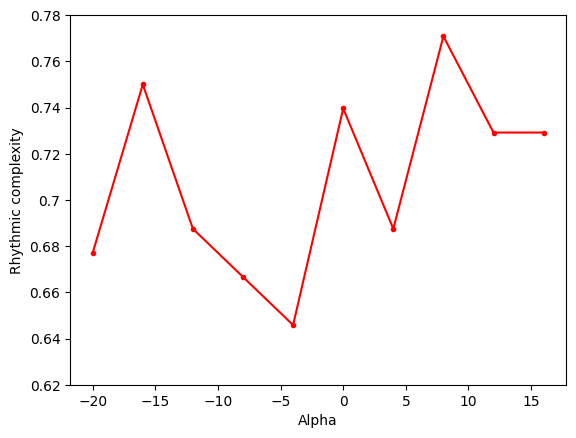

In [ ]:
plt.plot(alpha_all, rhythmic_complexity_all, 'red', marker = ".")

current_values = plt.gca().get_yticks()
plt.gca().set_yticks(current_values)
plt.gca().set_yticklabels(round(x,2) for x in current_values)

plt.xlabel('Alpha')
plt.ylabel('Rhythmic complexity')
plt.show()

#### Interpretability metric

In [ ]:
cnn_interpretability_metric(attribute="rhy")

Highest scoring dimension:  0
Regression score:  0.3564196228981018


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/loc

# Baseline models

## Linear Baseline

### Model

In [ ]:
class LINEAR_BASE(nn.Module):
    def __init__(self, latent_dim):  # Pianoroll input: 128 pitches, 96 time steps
        super(LINEAR_BASE, self).__init__()
        self.input_dim=128*96
        self.flatten_input = nn.Flatten()
        self.fc1 = nn.Linear(self.input_dim, 512)
        self.fc2 = nn.Linear(512, 256)
        self.fc31 = nn.Linear(256, latent_dim)  # mean
        self.fc32 = nn.Linear(256, latent_dim)  # logvar

        self.fc4 = nn.Linear(latent_dim, 256)
        self.fc5 = nn.Linear(256, 512)
        self.fc6 = nn.Linear(512, self.input_dim)

    def encode(self, x):
        x = self.flatten_input(x)
        h = F.relu(self.fc1(x))
        h = F.relu(self.fc2(h))
        return self.fc31(h), self.fc32(h)

    def reparameterise(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        h = F.relu(self.fc4(z))
        h = F.relu(self.fc5(h))
        return torch.sigmoid(self.fc6(h))

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterise(mu, logvar)
        z = self.decode(z)
        z = z.reshape(-1, 128, 96)
        return z, mu, logvar

# Instantiate the model with 64 latent dimensions
LATENT_DIM = 64
model = LINEAR_BASE(LATENT_DIM)

In [ ]:
# Outputs a summary of the model for manual checks
summary(model, input_size=(1, 1, 128, 96))

Layer (type:depth-idx)                   Output Shape              Param #
LINEAR_BASE                              [1, 128, 96]              --
├─Flatten: 1-1                           [1, 12288]                --
├─Linear: 1-2                            [1, 512]                  6,291,968
├─Linear: 1-3                            [1, 256]                  131,328
├─Linear: 1-4                            [1, 64]                   16,448
├─Linear: 1-5                            [1, 64]                   16,448
├─Linear: 1-6                            [1, 256]                  16,640
├─Linear: 1-7                            [1, 512]                  131,584
├─Linear: 1-8                            [1, 12288]                6,303,744
Total params: 12,908,160
Trainable params: 12,908,160
Non-trainable params: 0
Total mult-adds (Units.MEGABYTES): 12.91
Input size (MB): 0.05
Forward/backward pass size (MB): 0.11
Params size (MB): 51.63
Estimated Total Size (MB): 51.79

### Training (NB: Not required for evaluation)

#### Loss function

Baseline model uses the conventional VAE loss function, with no attribute-specific regularisation term.

In [ ]:
def loss_fn(recon_x, x, mu, logvar):
  # Standard VAE loss function computes the sum of the reconstruction loss (binary cross-entropy) and the KL divergence.
  BCE = F.binary_cross_entropy(recon_x, x, reduction='sum')
  KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
  KLD_coef = 0.1 # to keep consistent with LSR models

  return BCE + KLD_coef * KLD

#### Training loop

In [ ]:
BATCH_SIZE = 100
optimiser = torch.optim.Adam(model.parameters(), lr=1e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimiser, step_size=5, gamma=0.1)
data_loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

def train(model, device, train_loader, optimiser, epoch):
  model.to(device)
  model.train()
  train_loss = 0
  for batch_idx, data in enumerate(train_loader):
      data = data.to(device)
      optimiser.zero_grad()
      recon_batch, mu, logvar = model(data)

      loss = loss_fn(recon_batch, data, mu, logvar)
      loss.backward()
      train_loss += loss.item()
      optimiser.step()

  avg_loss = train_loss / len(train_loader.dataset)
  print(f'Epoch {epoch}, Loss: {avg_loss}')
  return avg_loss

def train_loop(epochs):
  losses = []
  for epoch in range(1, epochs + 1):
    avg_loss = train(model, device, data_loader, optimiser, epoch)
    losses.append(avg_loss)
    scheduler.step()

  plt.figure(figsize=(10, 5))
  plt.plot(range(1, epochs+1), losses, marker='o', label='Training Loss')
  plt.xlabel('Epoch')
  plt.ylabel('Loss')
  plt.title('Loss Over Epochs')
  plt.legend()
  plt.show()

Epoch 1, Loss: 4782.2294156543885
Epoch 2, Loss: 1367.8068671630094
Epoch 3, Loss: 1196.710496669279
Epoch 4, Loss: 1157.726819651254
Epoch 5, Loss: 1125.0825639204545
Epoch 6, Loss: 1111.4725031837775
Epoch 7, Loss: 1109.6624338753918
Epoch 8, Loss: 1108.15574794279
Epoch 9, Loss: 1107.6833121081504
Epoch 10, Loss: 1105.3795307601881
Epoch 11, Loss: 1105.7504285854232
Epoch 12, Loss: 1105.4168666731975
Epoch 13, Loss: 1105.8433581504703
Epoch 14, Loss: 1105.4156115301723
Epoch 15, Loss: 1105.2246583561912
Epoch 16, Loss: 1104.8578259698277
Epoch 17, Loss: 1105.671054565047
Epoch 18, Loss: 1105.4914589047805
Epoch 19, Loss: 1104.841227468652
Epoch 20, Loss: 1104.3413131857367


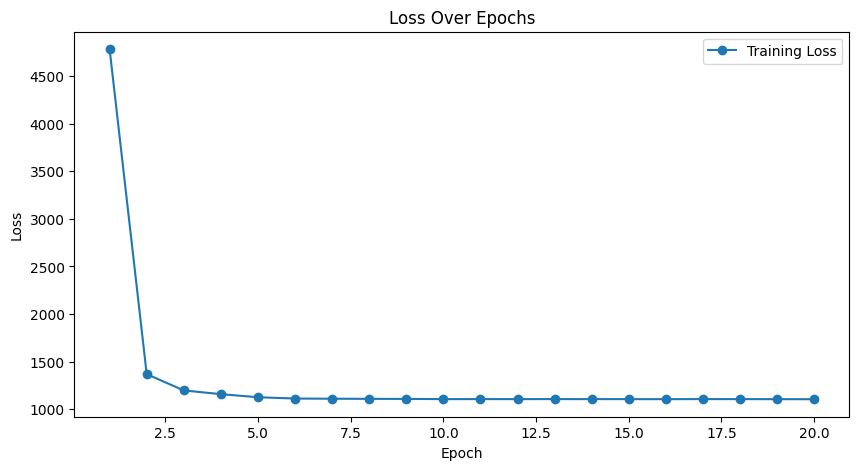

In [ ]:
train_loop(epochs=20)

#### Save model

In [ ]:
torch.save(model.state_dict(), './LINEAR_BASE_XXXX2025.pth')

In [ ]:
files.download('./LINEAR_BASE_XXXX2025.pth')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Load model

In [ ]:
# Run if using the pre-trained model.
# If you have trained your own model in the same session, skip this code block.
# If you have trained your own model in a previous session, load your own .pth file below.
model = LINEAR_BASE(LATENT_DIM)
model.load_state_dict(torch.load('LINEAR_BASE.pth'))

<All keys matched successfully>

### Evaluation - modal pitch

#### Plot

In [ ]:
model.eval()

modal_pitch_all = []
alpha_all       = []

for alpha in np.arange(-20, 20, 4):
  modal_pitch = cnn_vary_constrained_latent_dim(1, alpha, attribute="mod")
  modal_pitch_all.append(modal_pitch)

  alpha_all.append(alpha)

Alpha = -20
Most common pitch: F3


Alpha = -16
Most common pitch: B2


Alpha = -12
Most common pitch: G4


Alpha = -8
Most common pitch: D#1


Alpha = -4
Most common pitch: G5


Alpha = 0
Most common pitch: B5


Alpha = 4
Most common pitch: D5


Alpha = 8
Most common pitch: G0


Alpha = 12
Most common pitch: G4


Alpha = 16
Most common pitch: C#4


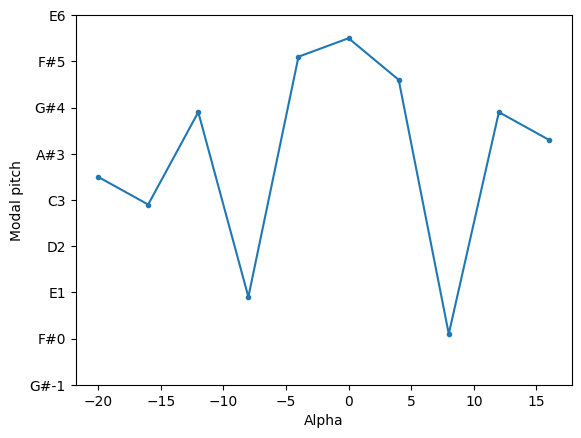

In [ ]:
plt.plot(alpha_all, modal_pitch_all, marker = ".")

current_values = plt.gca().get_yticks()
plt.gca().set_yticks(current_values)
plt.gca().set_yticklabels(pitch_num_to_name(int(x)) for x in current_values)

plt.xlabel('Alpha')
plt.ylabel('Modal pitch')
plt.show()

#### Interpretability metric

In [ ]:
linear_interpretability_metric(attribute="mod")

Highest scoring dimension:  45
Regression score:  3.5762786865234375e-07


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/loc

### Evaluation - rhythmic complexity

#### Plot

In [ ]:
model.eval()

rhythmic_complexity_all = []
alpha_all               = []

for alpha in np.arange(-20, 20, 4):
  rhythmic_complexity = linear_vary_constrained_latent_dim(1, alpha, attribute="rhy")
  rhythmic_complexity_all.append(rhythmic_complexity)
  alpha_all.append(alpha)

Alpha = -20
Most common pitch: G3


Alpha = -16
Most common pitch: D#3


Alpha = -12
Most common pitch: E4


Alpha = -8
Most common pitch: F1


Alpha = -4
Most common pitch: G5


Alpha = 0
Most common pitch: E0


Alpha = 4
Most common pitch: G5


Alpha = 8
Most common pitch: D1


Alpha = 12
Most common pitch: B3


Alpha = 16
Most common pitch: B3


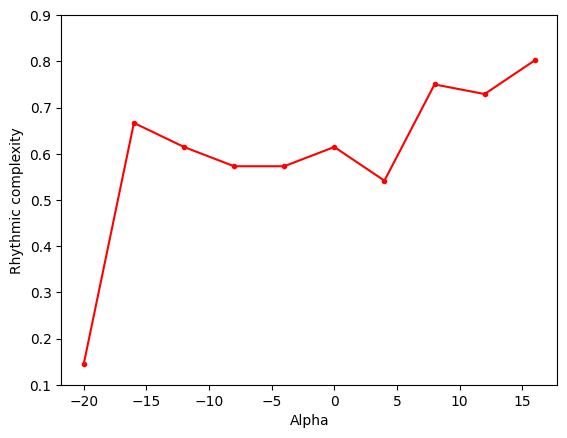

In [ ]:
plt.plot(alpha_all, rhythmic_complexity_all, 'red', marker = ".")

current_values = plt.gca().get_yticks()
plt.gca().set_yticks(current_values)
plt.gca().set_yticklabels(round(x,2) for x in current_values)

plt.xlabel('Alpha')
plt.ylabel('Rhythmic complexity')
plt.show()

#### Interpretability metric

In [ ]:
linear_interpretability_metric(attribute="rhy")

Highest scoring dimension:  1
Regression score:  0.0009282231330871582


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/loc

## CNN Baseline

### Model

In [ ]:
LATENT_DIM = 64

In [ ]:
class CNN_BASE(nn.Module):
    def __init__(self, latent_dim):  # Pianoroll input: 128 pitches, 96 time steps
        super(CNN_BASE, self).__init__()
        self.latent_dim = latent_dim
        self.input_size=128*96
        self.flattened_size = 1120
        #self.flatten_input = nn.Flatten()
        self.encoder_layers = nn.Sequential(
        nn.Conv2d(1, 512, kernel_size=3, stride=2, padding=2),
        nn.BatchNorm2d(512),
        nn.ReLU(),
        nn.Conv2d(512, 256, kernel_size=3, stride=2, padding=2),
        nn.BatchNorm2d(256),
        nn.ReLU(),
        nn.Conv2d(256, 128, kernel_size=3, stride=2, padding=1),
        nn.BatchNorm2d(128),
        nn.ReLU(),
        nn.Conv2d(128, 64, kernel_size=3, stride=2, padding=1),
        nn.BatchNorm2d(64),
        nn.ReLU(),
        nn.Conv2d(64, 32, kernel_size=3, stride=(2,1), padding=1),
        nn.Flatten(),
        )

        self.fc1 = nn.Linear(self.flattened_size, self.latent_dim)  # mean
        self.fc2 = nn.Linear(self.flattened_size, self.latent_dim)  # logvar

        self.decoder_fc = nn.Linear(in_features=self.latent_dim, out_features=self.flattened_size)

        self.decoder_layers = nn.Sequential(
          nn.ConvTranspose2d(32, 32, kernel_size=3, stride=(2,1), padding=1),
          nn.BatchNorm2d(32),
          nn.ReLU(),
          nn.ConvTranspose2d(32, 64, kernel_size=3, stride=2, padding=1),
          nn.BatchNorm2d(64),
          nn.ReLU(),
          nn.ConvTranspose2d(64, 128, kernel_size=3, stride=2, padding=1),
          nn.BatchNorm2d(128),
          nn.ReLU(),
          nn.ConvTranspose2d(128, 256, kernel_size=3, stride=2, padding=1),
          nn.BatchNorm2d(256),
          nn.ReLU(),
          nn.ConvTranspose2d(256, 1, kernel_size=3, stride=2, padding=2, output_padding=1),
          nn.Sigmoid()
        )

    def encode(self, x):
        x = self.encoder_layers(x)
        mu = self.fc1(x)
        logvar = self.fc2(x)
        return mu, logvar

    def reparameterise(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        z = self.decoder_fc(z)
        z = z.reshape(-1, 32, 5, 7)
        z = self.decoder_layers(z)
        return z

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterise(mu, logvar)
        z = self.decode(z)
        return z, mu, logvar

# Instantiate the model with the specified latent dimensions
model = CNN_BASE(LATENT_DIM)

In [ ]:
# Outputs a summary of the model for manual checks
summary(model, input_size=(98, 1, 128, 96))

Layer (type:depth-idx)                   Output Shape              Param #
CNN_BASE                                 [98, 1, 128, 96]          --
├─Sequential: 1-1                        [98, 1120]                --
│    └─Conv2d: 2-1                       [98, 512, 65, 49]         5,120
│    └─BatchNorm2d: 2-2                  [98, 512, 65, 49]         1,024
│    └─ReLU: 2-3                         [98, 512, 65, 49]         --
│    └─Conv2d: 2-4                       [98, 256, 34, 26]         1,179,904
│    └─BatchNorm2d: 2-5                  [98, 256, 34, 26]         512
│    └─ReLU: 2-6                         [98, 256, 34, 26]         --
│    └─Conv2d: 2-7                       [98, 128, 17, 13]         295,040
│    └─BatchNorm2d: 2-8                  [98, 128, 17, 13]         256
│    └─ReLU: 2-9                         [98, 128, 17, 13]         --
│    └─Conv2d: 2-10                      [98, 64, 9, 7]            73,792
│    └─BatchNorm2d: 2-11                 [98, 64, 9, 7]      

### Training (NB: Not required for evaluation)

#### Loss function

In [ ]:
def loss_fn(recon_x, x, mu, logvar):
  # Standard VAE loss function computes the sum of the reconstruction loss (binary cross-entropy) and the KL divergence.
  recon_x = recon_x.squeeze(1)
  BCE = F.binary_cross_entropy(recon_x, x, reduction='sum')
  KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
  KLD_coef = 0.1 # to keep consistent with LSR models

  return BCE + KLD_coef * KLD

#### Training loop

In [ ]:
optimiser = torch.optim.Adam(model.parameters(), lr=1e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimiser, step_size=5, gamma=0.1)
data_loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

def train(model, device, train_loader, optimiser, epoch):
  model.to(device)
  model.train()
  train_loss = 0
  for batch_idx, data in enumerate(train_loader):
      data = data.to(device)
      optimiser.zero_grad()
      data = data.unsqueeze(1)
      recon_batch, mu, logvar = model(data)
      data = data.squeeze(1)

      loss = loss_fn(recon_batch, data, mu, logvar)
      loss.backward()
      train_loss += loss.item()
      optimiser.step()

  avg_loss = train_loss / len(train_loader.dataset)
  print(f'Epoch {epoch}, Loss: {avg_loss}')
  return avg_loss

def train_loop(epochs):
  losses = []
  for epoch in range(1, epochs + 1):
    avg_loss = train(model, device, data_loader, optimiser, epoch)
    losses.append(avg_loss)
    scheduler.step()

  plt.figure(figsize=(10, 5))
  plt.plot(range(1, epochs+1), losses, marker='o', label='Training Loss')
  plt.xlabel('Epoch')
  plt.ylabel('Loss')
  plt.title('Loss Over Epochs')
  plt.legend()
  plt.show()

In [ ]:
train_loop(epochs=20)

KeyboardInterrupt: 

#### Save model

In [ ]:
torch.save(model.state_dict(), './CNN_BASE_XXXX2025.pth')

In [ ]:
files.download('./CNN_BASE_XXXX2025.pth')

### Load model

In [ ]:
# Run if using the pre-trained model.
# If you have trained your own model in the same session, skip this code block.
# If you have trained your own model in a previous session, load your own .pth file below.
model = CNN_BASE(LATENT_DIM)
model.load_state_dict(torch.load('CNN_BASE.pth'))

<All keys matched successfully>

### Evaluation - modal pitch

#### Plot

In [ ]:
model.eval()

modal_pitch_all = []
alpha_all       = []

for alpha in np.arange(-20, 20, 4):
  modal_pitch = cnn_vary_constrained_latent_dim(1, alpha, attribute="mod")
  modal_pitch_all.append(modal_pitch)

  alpha_all.append(alpha)

Alpha = -20
Most common pitch: E6


Alpha = -16
Most common pitch: C-1


Alpha = -12
Most common pitch: G8


Alpha = -8
Most common pitch: G-1


Alpha = -4
Most common pitch: D#0


Alpha = 0
Most common pitch: B-1


Alpha = 4
Most common pitch: B-1


Alpha = 8
Most common pitch: B-1


Alpha = 12
Most common pitch: B-1


Alpha = 16
Most common pitch: G-1


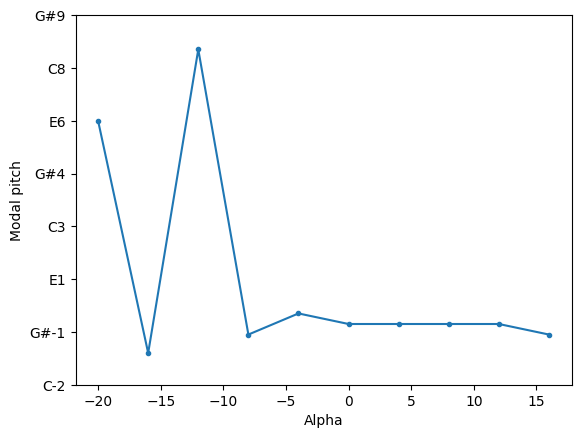

In [ ]:
plt.plot(alpha_all, modal_pitch_all, marker = ".")

current_values = plt.gca().get_yticks()
plt.gca().set_yticks(current_values)
plt.gca().set_yticklabels(pitch_num_to_name(int(x)) for x in current_values)

plt.xlabel('Alpha')
plt.ylabel('Modal pitch')
plt.show()

#### Interpretability metric

In [ ]:
cnn_interpretability_metric(attribute="mod")

Highest scoring dimension:  60
Regression score:  -1.1920928955078125e-07


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/usr/loc

### Evaluation - rhythmic complexity

#### Plot

In [ ]:
model.eval()

rhythmic_complexity_all = []
alpha_all               = []

for alpha in np.arange(-20, 10, 1):
  rhythmic_complexity = cnn_vary_constrained_latent_dim(1, alpha, attribute="rhy")
  rhythmic_complexity_all.append(rhythmic_complexity)

  alpha_all.append(alpha)

Alpha = -20
Most common pitch: D#-1


Alpha = -19
Most common pitch: D#-1


Alpha = -18
Most common pitch: C7


Alpha = -17
Most common pitch: E-2


Alpha = -16
Most common pitch: D#-1


Alpha = -15
Most common pitch: D#-2


Alpha = -14
Most common pitch: D#7


Alpha = -13
Most common pitch: D#7


Alpha = -12
Most common pitch: G-2


Alpha = -11
Most common pitch: B7


Alpha = -10
Most common pitch: G6


Alpha = -9
Most common pitch: D#-2


Alpha = -8
Most common pitch: G-1


Alpha = -7
Most common pitch: G-1


Alpha = -6
Most common pitch: B-1


Alpha = -5
Most common pitch: B-1


Alpha = -4
Most common pitch: B-1


Alpha = -3
Most common pitch: B-1


Alpha = -2
Most common pitch: B-1


Alpha = -1
Most common pitch: G-1


Alpha = 0
Most common pitch: B-1


Alpha = 1
Most common pitch: B-1


Alpha = 2
Most common pitch: B-1


Alpha = 3
Most common pitch: G5


Alpha = 4
Most common pitch: D#0


Alpha = 5
Most common pitch: D#0


Alpha = 6
Most common pitch: G-1


Alpha = 7
Most common pitch: B-1


Alpha = 8
Most common pitch: B-1


Alpha = 9
Most common pitch: G8


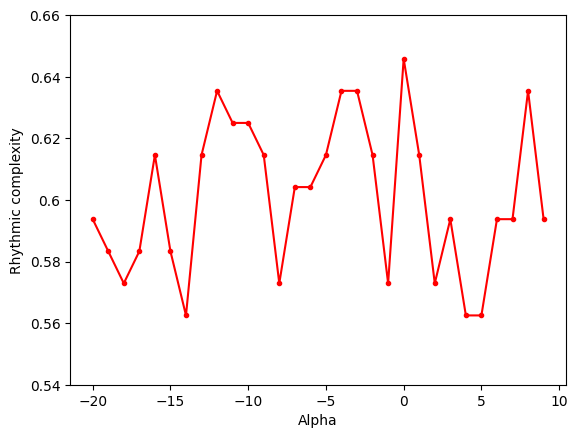

In [ ]:
plt.plot(alpha_all, rhythmic_complexity_all, 'red', marker = ".")

current_values = plt.gca().get_yticks()
plt.gca().set_yticks(current_values)
plt.gca().set_yticklabels(round(x,2) for x in current_values)

plt.xlabel('Alpha')
plt.ylabel('Rhythmic complexity')
plt.show()

#### Interpretability metric

In [ ]:
cnn_interpretability_metric(attribute="rhy")

Highest scoring dimension:  18
Regression score:  0.007986128330230713


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/cluster/_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
/usr/loc